## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## Compute the camera calibration and distortion coefficients using chessboard images

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

def calibrate_camera(files, nx, ny):
    ## from http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

    objpoints = []
    imgpoints = []
    files_used = []
    
    for fname in files:
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
        if ret:
            objpoints.append(objp)
            imgpoints.append(corners)
            files_used.append(fname)
    rms, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[:2],None,None)
    return mtx, dist, files_used, gray.shape[:2]

filenames = glob.glob('camera_cal/*.jpg')
mtx, dist, files_used, (Y,X) =calibrate_camera(filenames, 9,6)
print(files_used)
print(X,Y)
# NB: values of X and Y (image shape), used as constants for further computations; mtx and dist are also used later

['camera_cal/calibration10.jpg', 'camera_cal/calibration11.jpg', 'camera_cal/calibration12.jpg', 'camera_cal/calibration13.jpg', 'camera_cal/calibration14.jpg', 'camera_cal/calibration15.jpg', 'camera_cal/calibration16.jpg', 'camera_cal/calibration17.jpg', 'camera_cal/calibration18.jpg', 'camera_cal/calibration19.jpg', 'camera_cal/calibration2.jpg', 'camera_cal/calibration20.jpg', 'camera_cal/calibration3.jpg', 'camera_cal/calibration6.jpg', 'camera_cal/calibration7.jpg', 'camera_cal/calibration8.jpg', 'camera_cal/calibration9.jpg']
1280 720


### Demonstrate unwarping of calibration chessboard images

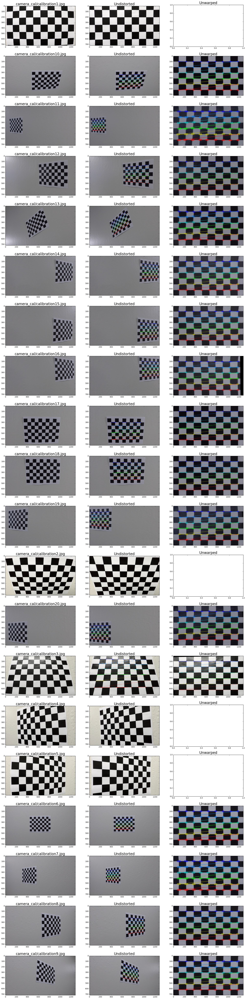

In [2]:
def corners_unwarp(img, nx, ny, mtx, dist):
    szY,szX=img.shape[:2]
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undist,cv2.COLOR_RGB2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    if ret:
        undist = cv2.drawChessboardCorners(undist, (nx,ny), corners, ret)
        src=np.float32([corners[0],corners[nx-1],corners[-(nx)],corners[-1]])
        offset=100
        dst=np.float32([[offset,offset],[szX-offset,offset],[offset,szY-offset],[szX-offset,szY-offset]])
        M = cv2.getPerspectiveTransform(src, dst)
        #Minv = cv2.getPerspectiveTransform(dst, src)
        warped = cv2.warpPerspective(undist, M, (szX,szY), flags=cv2.INTER_LINEAR)
        return undist,True,warped
    return undist,None,None
    
filenames = glob.glob('camera_cal/*.jpg')
# Plot the result
f, ax = plt.subplots(len(filenames), 3, figsize=(24, 5*len(filenames)))
ax_ind=0

for fname in filenames:
    image = mpimg.imread(fname)
    undist,could_warp,warped = corners_unwarp(image, 9, 6, mtx, dist)

    ax[ax_ind][0].set_title(fname, fontsize=20)
    ax[ax_ind][1].set_title('Undistorted', fontsize=20)
    ax[ax_ind][2].set_title('Unwarped', fontsize=20)
    
    ax[ax_ind][0].imshow(image)
    ax[ax_ind][1].imshow(undist)
    if could_warp: ax[ax_ind][2].imshow(warped, cmap='gray')
    ax_ind=ax_ind+1
plt.show()

## Distortion Correction Example

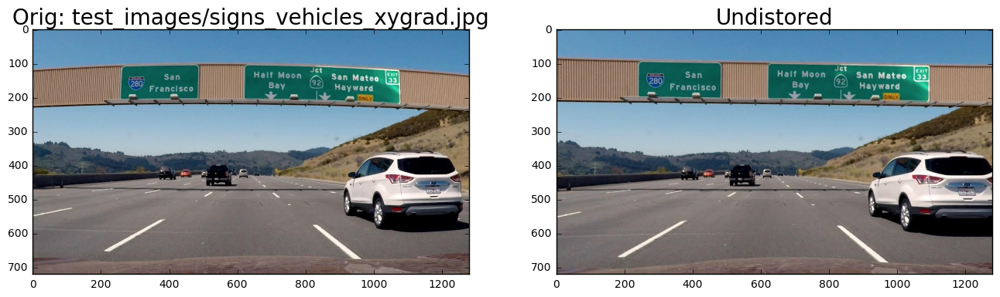

In [3]:
fname = 'test_images/signs_vehicles_xygrad.jpg'
image = mpimg.imread(fname)
undistorted = cv2.undistort(image, mtx, dist, None, mtx)
f, ax = plt.subplots(1, 2, figsize=(16, 7))
ax[0].set_title('Orig: '+fname, fontsize=20)
ax[1].set_title('Undistored', fontsize=20)
ax[0].imshow(image)
ax[1].imshow(undistorted)
plt.show()

## Filter Threshold

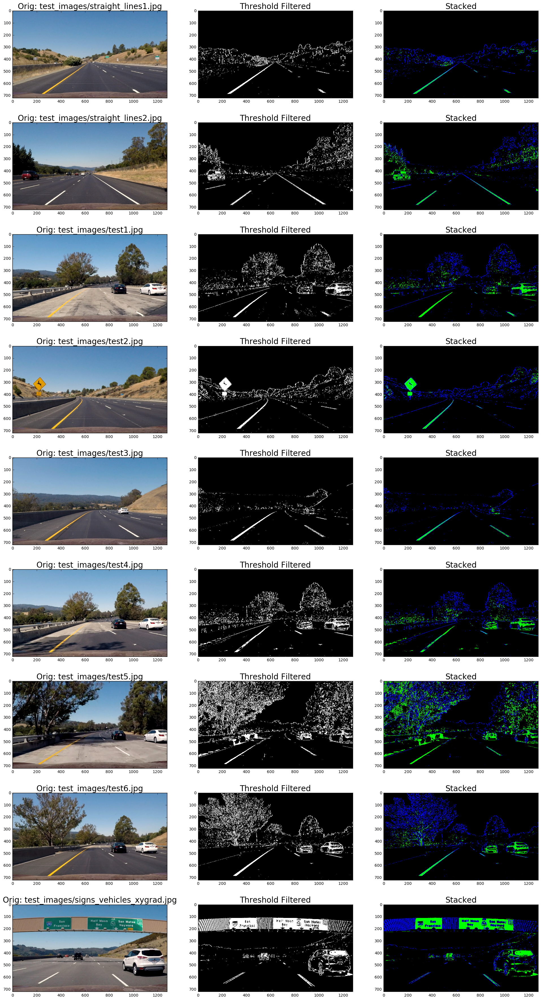

In [4]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Edit this function to create your own pipeline.
def filter_threshold(img, l_thresh=(150,255), s_thresh=(170, 255), sx_thresh=(30, 100), grad_thresh=(.8,1.2), showStacked=False):
    img = np.copy(img)
    #img = cv2.GaussianBlur(img, (5,5), 0)

    # Convert to HSV color space and separate the V channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    #h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    #l_binary = np.zeros_like(l_channel)
    #l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1

    # S channel
    #s_channel = cv2.Canny(np.uint8(s_channel), 50, 120)
    #black_img=np.zeros_like(img)
    #lines = cv2.HoughLinesP(s_channel, rho=1, theta=np.pi/180, threshold=250, minLineLength=30, maxLineGap=10)
    #if lines!=None:
    #    #print(len(lines))
    #    for line in lines:
    #        for x1,y1,x2,y2 in line:
    #            cv2.line(black_img,(x1,y1),(x2,y2),(255,255,255),5)
    #    s_channel = black_img[:,:,0]
    s_binary = np.uint8(np.zeros_like(s_channel))
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1  # THRESHOLD S channel
    
    # X
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0, ksize=5) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    x_binary = np.zeros_like(scaled_sobel)
    x_binary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1 # THRESHOLD L channel

    
    combined_binary = np.zeros_like(x_binary)
    combined_binary[((s_binary == 1)) | ((x_binary==1))] = 1

    color_binary = np.dstack(( np.zeros_like(combined_binary) , s_binary, x_binary)) if showStacked else None
    return combined_binary, color_binary
    #dir_binary = dir_threshold(image, sobel_kernel=31, thresh=grad_thresh)
    #color_binary = np.dstack(( dir_binary, s_binary, sx_binary)) if showStacked else None
    #return s_channel, black_img

# Plot the result
filenames = glob.glob('test_images/*.jpg')
f, ax = plt.subplots(len(filenames), 3, figsize=(24, 5*len(filenames)))
ax_ind=0

for fname in filenames:
    image = mpimg.imread(fname)
    combined_binary, color_binary = filter_threshold(image, showStacked=True)
    ax[ax_ind][0].set_title('Orig: '+fname, fontsize=20)
    ax[ax_ind][1].set_title('Threshold Filtered', fontsize=20)
    ax[ax_ind][2].set_title('Stacked', fontsize=20)

    ax[ax_ind][0].imshow(image)
    ax[ax_ind][1].imshow(combined_binary, cmap='gray')
    ax[ax_ind][2].imshow(color_binary*255)

    ax_ind=ax_ind+1

plt.show()

## Obtaining perspective transform and inverse transform matrices

In [5]:
### manually calibrate on straight line images
offset,x2_offset,warp_offset=175,45,350
y2, x0,x1,x2,x3=450, offset, X//2-x2_offset-1, X//2+x2_offset+3, X-offset+1

src=np.float32([[x0,Y],[x1,y2],[x2,y2],[x3,Y]])
dst=np.float32([[warp_offset,Y],[warp_offset,0],[X-warp_offset,0],[X-warp_offset,Y]])

lines=[[x0,Y,x1,y2],[x1,y2,x2,y2],[x2,y2,x3,Y]]
wlines=[[warp_offset,Y,warp_offset,0],[X-warp_offset,0,X-warp_offset,Y]]

perspMtx = cv2.getPerspectiveTransform(src, dst)
perspMtxInv = cv2.getPerspectiveTransform(dst, src)
# ^^^^^^ to get both perspective and inverse transform matrices ^^^^^^
print(src)
print(dst)

[[  175.   720.]
 [  594.   450.]
 [  688.   450.]
 [ 1106.   720.]]
[[ 350.  720.]
 [ 350.    0.]
 [ 930.    0.]
 [ 930.  720.]]


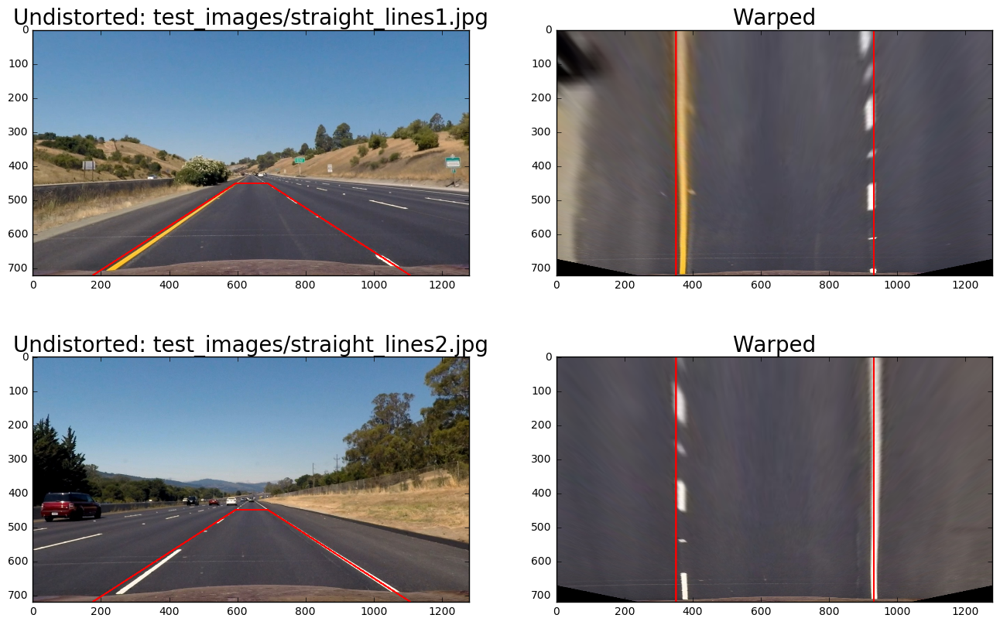

In [6]:
def draw_lines(img, lines, color=[255, 0, 0], thickness=3):
    for line in lines:
        x1,y1,x2,y2 = line
        cv2.line(img, (x1, y1), (x2, y2), color, thickness)  # raw lines
    return # raw lines

filenames = glob.glob('test_images/straight*.jpg')
f, ax = plt.subplots(len(filenames), 2, figsize=(16, 5*len(filenames)))
ax_ind=0
for fname in filenames:
    ax[ax_ind][0].set_title('Undistorted: '+fname, fontsize=20)
    ax[ax_ind][1].set_title('Warped', fontsize=20)

    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    warped = cv2.warpPerspective(undist, perspMtx, (X,Y), flags=cv2.INTER_LINEAR)
    draw_lines(undist, lines)
    draw_lines(warped, wlines)

    ax[ax_ind][0].imshow(undist)
    ax[ax_ind][1].imshow(warped)

    ax_ind=ax_ind+1
plt.show()

## Pipeline: Distortion correction, unwarping, filtering

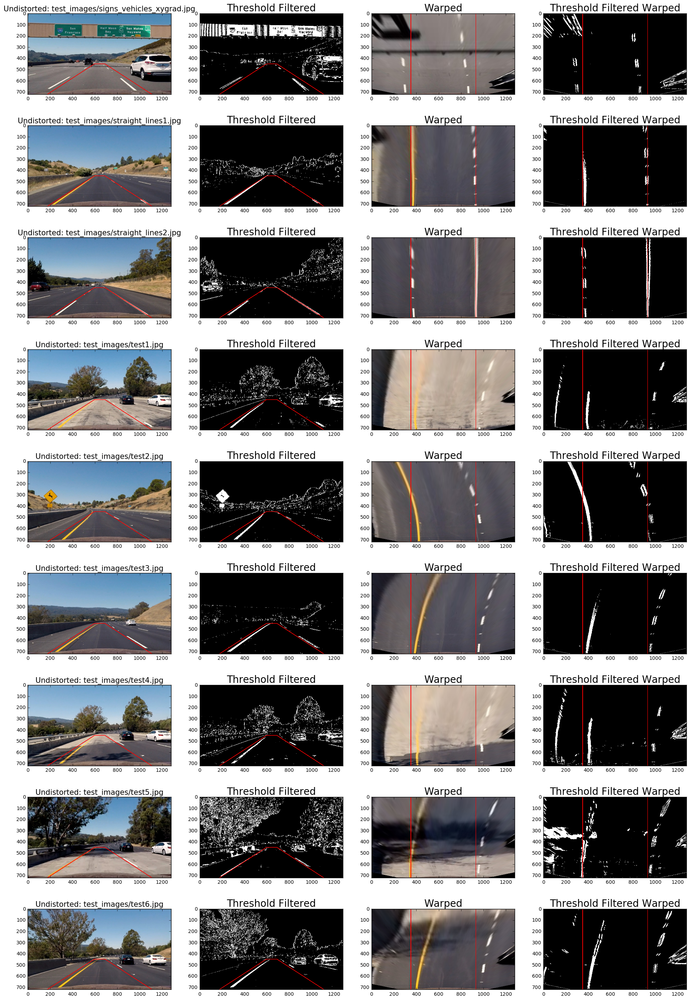

In [23]:
def pipeline(img, mtx, dist, perspMtx, visual=False, drawLines=False):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    warped = cv2.warpPerspective(undist, perspMtx, (X,Y), flags=cv2.INTER_LINEAR)

    filtered,stacked=filter_threshold(undist, showStacked=visual)
    warped_filtered,warped_stacked=filter_threshold(warped, showStacked=visual)
    #warped_filtered = cv2.warpPerspective(filtered, perspMtx, (X,Y), flags=cv2.INTER_LINEAR)
    if visual:
        undist1,warped1=np.copy(undist),np.copy(warped)
        filtered1=np.dstack((filtered,filtered,filtered))*255
        warped_filtered1=np.dstack((warped_filtered,warped_filtered,warped_filtered))*255
        if drawLines:
            draw_lines(undist1, lines)
            draw_lines(warped1, wlines)
            draw_lines(filtered1, lines)
            draw_lines(warped_filtered1, wlines)
    else:
        undist1,warped1,filtered1,warped_filtered1=None,None,None,None
    #result,stacked=pipeline(img)
    return warped_filtered,warped_stacked,filtered,stacked,undist1,warped1,filtered1,warped_filtered1

filenames = glob.glob('test_images/*.jpg')
#filenames = glob.glob('test_images/*.jpg')
f, ax = plt.subplots(len(filenames), 4, figsize=(24, 4*len(filenames)))
ax_ind=0
orig_images={fname:mpimg.imread(fname) for fname in filenames}
warped_filtered_images={}

for fname in sorted(orig_images.keys()):
    ax[ax_ind][0].set_title('Undistorted: '+fname, fontsize=15)
    ax[ax_ind][1].set_title('Threshold Filtered', fontsize=20)
    ax[ax_ind][2].set_title('Warped', fontsize=20)
    ax[ax_ind][3].set_title('Threshold Filtered Warped', fontsize=20)

    image = orig_images[fname]
    warped_filtered,warped_stacked,filtered,stacked,undist1,warped1,filtered1,warped_filtered1 = pipeline(image, mtx, dist, perspMtx, visual=True, drawLines=True)
    warped_filtered_images[fname]=warped_filtered

    ax[ax_ind][0].imshow(undist1)
    ax[ax_ind][1].imshow(filtered1)
    ax[ax_ind][2].imshow(warped1)
    ax[ax_ind][3].imshow(warped_filtered1)

    ax_ind=ax_ind+1
plt.show()

## Detect lane pixels and fit to find the lane boundary

### Helper Class `Line` to track and average over the last N detected lane lines

In [10]:
from collections import deque
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        self.detected = False        # was the line detected in the last iteration?
        self.recent_xfitted = deque(maxlen=self.averageOver)     # x values of the last n fits of the line
        self.bestx = None            # average x values of the fitted line over the last n iterations
        self.best_fit = None         #polynomial coefficients averaged over the last n iterations
        self.radius_of_curvature = None #radius of curvature of the line in some units
        self.line_base_pos = None    #distance in meters of vehicle center from the line

        self.current_fit = [np.array([False])]  #polynomial coefficients for the most recent fit
        self.diffs = np.array([0,0,0], dtype='float') #difference in fit coefficients between last and new fits
        self.allx = None             #x values for detected line pixels
        self.ally = None             #y values for detected line pixels

    def iterate(self, found_centers, x, y):
        if len(x)==0:
            print('No line detected, ignored')
            return

        # fit 2nd order polynomial in pixels and meters, and find radius of curvature
        self.current_fit = np.polyfit(y, x, 2)  # fit 2nd order polynomial in pixel corrdinates
        fit_cr = np.polyfit(y*ym_per_pix, x*xm_per_pix, 2) # fit 2nd order polynomial in world coordinates (meters)
        m_curve=((1 + (2*fit_cr[0]*Y*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0]) # curvature in meters

        if m_curve<self.minCurve and self.detected:
            print('too sharp curve, ignoring this iteration datapoint ', m_curve)
            return
        self.diffs = self.best_fit - self.current_fit if self.detected else self.diffs
        if np.sum(np.abs(self.diffs))>self.maxDiff and self.detected:
            print('too variant, ignored', self.diffs)
            return
        
        # project over all height (Y coordinates) of image
        fitx = self.current_fit[0]*self.ploty()**2 + self.current_fit[1]*self.ploty() + self.current_fit[2]
        self.recent_xfitted.append(fitx) # append, dequeue only keeps last N values
        self.bestx = np.average(self.recent_xfitted, axis=0) # average to get current best estimate
        
        # best fit obtained on average over last N iterations (to be precise, avergae of last N detected lanes)
        self.best_fit = np.polyfit(self.ploty(), self.bestx, 2) # 2nd order polynomial fitting
        self.allx = self.best_fit[0]*self.ploty()**2 + self.best_fit[1]*self.ploty() + self.best_fit[2] # LANE LINE

        # Curvature
        fit_cr = np.polyfit(self.ploty()*ym_per_pix, self.allx*xm_per_pix, 2)
        self.radius_of_curvature = ((1 + (2*fit_cr[0]*Y*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
        
        # use the bottom most point if the lane line to detect offset from center
        self.line_base_pos=xm_per_pix*(self.allx[-1]+self.allx[-1]-X)/2
        
        self.detected = True

    __ploty=None
    imShape=None
    averageOver=5
    minCurve=50.
    maxDiff=200.
    @classmethod
    def ploty(cls):
        if cls.__ploty==None: cls.__ploty = np.linspace(0, Line.imShape[0]-1, Line.imShape[0])
        return cls.__ploty

Line.imShape = (Y,X)
LeftLane,RightLane=Line(),Line()

(720, 1280)


### Use sliding window to detect initial left and and right lanes; uses histogram peaks in bottom quadrants of image

/home/kswaroop/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:57: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


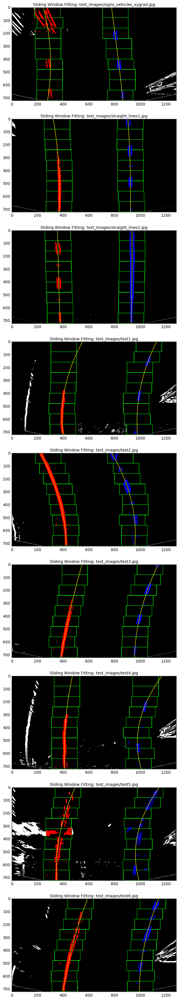

In [11]:
def init_slide_win(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    return leftx_base, rightx_base

def slide_win_fit_poly(binary_warped, nwindows=9, margin=100, minpix=50, visual=True):
    leftx_base, rightx_base=init_slide_win(binary_warped)
    leftx_current, rightx_current = leftx_base, rightx_base
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    left_found_centers, right_found_centers = [],[]
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255 if visual else None

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            left_found_centers.append([window, leftx_current])
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            right_found_centers.append([window, rightx_current])

        if visual: # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    LeftLane.iterate(left_found_centers, nonzerox[left_lane_inds], nonzeroy[left_lane_inds])
    RightLane.iterate(right_found_centers, nonzerox[right_lane_inds], nonzeroy[right_lane_inds])

    # Fit a second order polynomial to each
    left_fit = LeftLane.best_fit # np.polyfit(lefty, leftx, 2)
    right_fit = RightLane.best_fit # np.polyfit(righty, rightx, 2)

    if visual: # Generate x and y values for plotting
        ploty = Line.ploty() #np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2] if LeftLane.detected else None
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2] if RightLane.detected else None
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    return out_img, left_fitx, right_fitx, leftx_base, rightx_base

f, ax = plt.subplots(len(filenames), 1, figsize=(24, 5*len(filenames)))
ax_ind=0

for fname in sorted(warped_filtered_images.keys()):
    LeftLane,RightLane=Line(),Line()
    out_img, left_fitx, right_fitx, leftx_base, rightx_base = slide_win_fit_poly(warped_filtered_images[fname], visual=True)
    ax[ax_ind].set_title('Sliding Window Fitting: '+fname, fontsize=10)
    ax[ax_ind].set_xlim([0, 1280])
    ax[ax_ind].set_ylim([720, 0])
    #left_lane_ind=((left_fitx>=0)&(left_fitx<1280)).nonzero()[0]
    #out_img[ploty[left_lane_ind], left_fitx[left_lane_ind]] = [0,255,255]
    ax[ax_ind].imshow(out_img)
    if LeftLane.detected: ax[ax_ind].plot(left_fitx, Line.ploty(), color='yellow')
    if RightLane.detected: ax[ax_ind].plot(right_fitx, Line.ploty(), color='yellow')
    ax_ind=ax_ind+1    

plt.show()

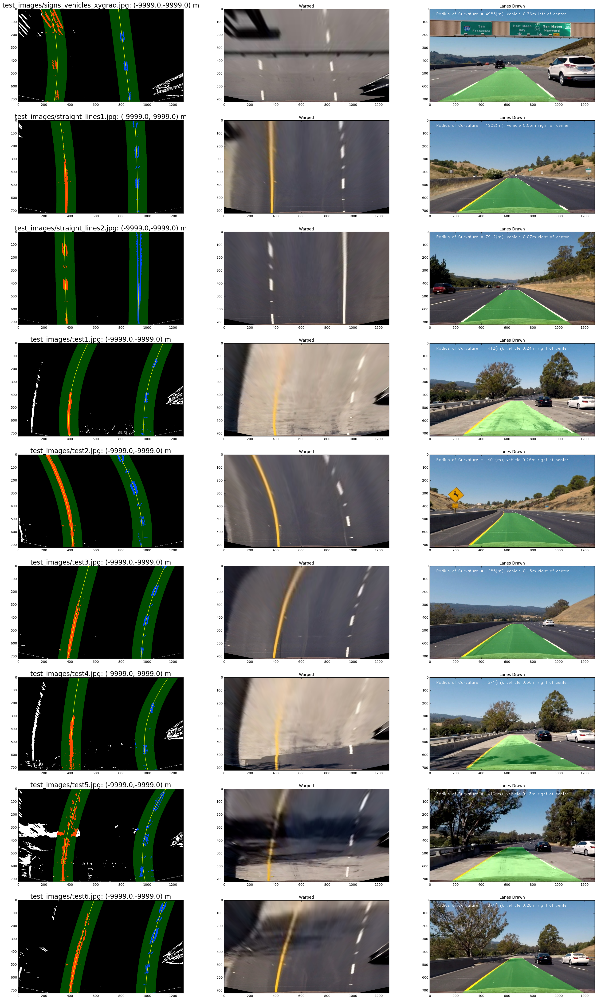

In [25]:
def search_lanes(orig_image, visual=False):
    binary_warped,warped_stacked,filtered,stacked,undist1,warped1,filtered1,warped_filtered1 = pipeline(orig_image, mtx, dist, perspMtx, visual)
    out_img1 = None
    if not LeftLane.detected:
        out_img1, left_fitx1, right_fitx1, leftx_base, rightx_base = slide_win_fit_poly(binary_warped, visual=visual)
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 75 #100
    left_fit,right_fit, left_lane_inds,right_lane_inds, off_centerm=LeftLane.best_fit, RightLane.best_fit, None, None, 0
    leftm_curve, rightm_curve, pts_left, pts_right = 0., 0., None, None
    if LeftLane.detected:
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        LeftLane.iterate([], nonzerox[left_lane_inds], nonzeroy[left_lane_inds])
        left_fitx = LeftLane.allx # left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        off_centerm += LeftLane.line_base_pos
        pts_left = np.array([np.transpose(np.vstack([left_fitx, Line.ploty()]))])
        leftm_curve = LeftLane.radius_of_curvature #  ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    if RightLane.detected:
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
        RightLane.iterate([], nonzerox[right_lane_inds], nonzeroy[right_lane_inds])
        right_fitx = RightLane.allx # right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        off_centerm += RightLane.line_base_pos
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, Line.ploty()])))])
        rightm_curve = RightLane.radius_of_curvature # ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    off_centerm=off_centerm/2

    # Recast the x and y points into usable format for cv2.fillPoly()
    if not LeftLane.detected: pts_left = np.array([np.transpose(np.vstack([np.zeros_like(Line.ploty()), Line.ploty()]))])
    if not RightLane.detected: pts_right = np.array([np.transpose(np.vstack([np.zeros_like(Line.ploty()), Line.ploty()]))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, perspMtxInv, (X, Y))
    # Combine the result with the undistorted image
    lanes_image = cv2.addWeighted(undist1, 1, newwarp, 0.3, 0)
    cv2.putText(lanes_image, 'Radius of Curvature = {:4.0f}(m), vehicle {:3.2f}m {} of center'
                             .format((leftm_curve+rightm_curve)/2., abs(off_centerm), 'left' if off_centerm<0 else 'right'),
                             (50,50), cv2.FONT_HERSHEY_DUPLEX, 1, (255,255,255))

    out_img=None
    if visual: # Create an image to draw on and an image to show the selection window        
        out_img=np.dstack((binary_warped, binary_warped, binary_warped))*255 if LeftLane.detected else out_img1
        window_img = np.zeros_like(out_img)
        if LeftLane.detected:
            out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
            left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, Line.ploty()]))])
            left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, Line.ploty()])))])
            left_line_pts = np.hstack((left_line_window1, left_line_window2))
            cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        if RightLane.detected:
            out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
            right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, Line.ploty()]))])
            right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, Line.ploty()])))])
            right_line_pts = np.hstack((right_line_window1, right_line_window2))
            cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

    return lanes_image,binary_warped,warped_stacked,filtered,stacked,warped1,out_img

f, ax = plt.subplots(len(filenames), 3, figsize=(32, 6*len(filenames)))
ax_ind=0

for fname in sorted(orig_images.keys()):
    LeftLane,RightLane=Line(),Line()
    #ploty, left_fit, right_fit, out_img, left_fitx, right_fitx, leftx_base, rightx_base = slide_win_fit_poly(warped_filtered_images[fname], visual=True)
    lanes_image,binary_warped,warped_stacked,filtered,stacked,warped1,out_img = search_lanes(orig_images[fname], visual=True)
    #print(left_fitx[-3:], right_fitx[-3:])
    left_radius, right_radius = LeftLane.radius_of_curvature, RightLane.radius_of_curvature
    if LeftLane.detected: left_radius = -9999
    if RightLane.detected: right_radius = -9999
    ax[ax_ind][0].set_title('{}: ({:1.1f},{:1.1f}) m'.format(fname,left_radius, right_radius), fontsize=20)
    ax[ax_ind][0].set_xlim([0, 1280])
    ax[ax_ind][0].set_ylim([720, 0])
    ax[ax_ind][0].imshow(out_img)
    if LeftLane.detected: ax[ax_ind][0].plot(LeftLane.allx, Line.ploty(), color='yellow')
    if RightLane.detected: ax[ax_ind][0].plot(RightLane.allx, Line.ploty(), color='yellow')
    
    ax[ax_ind][1].set_title('Warped')
    ax[ax_ind][1].imshow(warped1)
    ax[ax_ind][2].set_title('Lanes Drawn')
    ax[ax_ind][2].imshow(lanes_image)
    ax_ind=ax_ind+1

plt.show()

In [14]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

def process_image(img, debug=False):
    lanes_image,binary_warped,warped_stacked,filtered,stacked,warped1,out_img = search_lanes(img, visual=True)
    fin_img=lanes_image
    if debug:
        fin_img1=np.vstack([img,lanes_image])
        fin_img2=np.vstack([stacked,warped_stacked])*255
        fin_img=np.hstack([fin_img1,fin_img2])
        fin_img=cv2.resize(fin_img, (X,Y))
    return fin_img

def process_image_debug(img):
    return process_image(img, True)


In [26]:
Line.averageOver=10
LeftLane,RightLane=Line(),Line()
vidname='project_video'
output = vidname+'_output.mp4'
clip1 = VideoFileClip(vidname+'.mp4')

clip = clip1.fl_image(process_image)
%time clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


 44%|████▍     | 556/1261 [01:39<02:07,  5.52it/s]

too variant, ignored [  6.74741327e-04  -7.99666923e-01   2.31119777e+02]


 45%|████▍     | 567/1261 [01:41<01:50,  6.30it/s]

too variant, ignored [  1.08723976e-03  -1.16961642e+00   3.00015007e+02]


 45%|████▌     | 571/1261 [01:41<01:54,  6.04it/s]

too variant, ignored [ -7.36171438e-04   9.00946302e-01  -2.76840594e+02]


 46%|████▌     | 575/1261 [01:42<01:57,  5.85it/s]

too variant, ignored [  7.47897361e-04  -9.06034083e-01   2.68697298e+02]
too variant, ignored [  8.69547301e-04  -1.06854043e+00   3.20829423e+02]


 46%|████▋     | 584/1261 [01:44<01:53,  5.94it/s]

too variant, ignored [  7.54606586e-04  -8.99614526e-01   2.61797705e+02]


100%|█████████▉| 1260/1261 [03:42<00:00,  5.75it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 24min 52s, sys: 49.3 s, total: 25min 41s
Wall time: 3min 43s


In [27]:
HTML("""
<video width="{}" height="{}" controls>
  <source src="{}">
</video>
""".format(X//2,Y//2,output))

In [32]:
Line.averageOver=5
Line.minCurve=0
Line.maxDiff=100000
vidname='challenge_video'
output = vidname+'_output.mp4'
clip1 = VideoFileClip(vidname+'.mp4')
LeftLane,RightLane=Line(),Line()

clip = clip1.fl_image(process_image)
%time clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [01:19<00:00,  5.76it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 8min 51s, sys: 17.1 s, total: 9min 8s
Wall time: 1min 19s


In [33]:
HTML("""
<video width="{}" height="{}" controls>
  <source src="{}">
</video>
""".format(X//2,Y//2,output))

In [34]:
vidname='harder_challenge_video'
output = vidname+'_output.mp4'
clip1 = VideoFileClip(vidname+'.mp4')
LeftLane,RightLane=Line(),Line()

clip = clip1.fl_image(process_image)
%time clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [03:48<00:00,  4.47it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 24min 44s, sys: 50.1 s, total: 25min 34s
Wall time: 3min 49s


In [35]:
HTML("""
<video width="{}" height="{}" controls>
  <source src="{}">
</video>
""".format(X//2,Y//2,output))